# OPTIMIZING EXTERNAL MODEL PERFORMANCE FOR DRUG RESPONSE PREDICTION FROM RNA-SEQ DATA OF PERTURBED SAMPLES USING CLUSTERING AND WEIGHTED RIDGE REGRESSION

This project focuses on enhancing the external performance of a machine learning model for predicting drug response from RNA-seq data of perturbed samples. It builds upon the work of Szalai et al., where a model trained on the CTRP-L1000-24h dataset outperformed a model trained on the larger REMATCHED dataset when evaluated on the external Mix-seq dataset.

To address this performance gap, two strategies were explored:

1. Clustering-Based Weighted Ridge Regression: DBSCAN clustering was applied to a t-SNE-reduced version of the REMATCHED dataset. Sample weights were then assigned based on cluster-level metrics such as the mean and standard deviation of cell viability.

2. Weighted Ridge Regression Without Clustering: In this approach, weights were assigned directly to individual samples without prior clustering or dimensionality reduction.

The code below is used to achieve all the results from the BEP report.

## Importing all libraries and data sets

In [40]:
#importing all libraries
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler
import numpy as np
import plotly.express as px
from sklearn.cluster import KMeans
from sklearn import metrics
from scipy.spatial.distance import cdist
import joblib
from sklearn.decomposition import PCA
from PIL import Image
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from sklearn.linear_model import Ridge
from sklearn.model_selection import train_test_split
from scipy.stats import pearsonr as pcor
from sklearn.neighbors import NearestNeighbors
from sklearn.neighbors import kneighbors_graph
import igraph as ig
import leidenalg
from sklearn.cluster import DBSCAN
from collections import defaultdict
from tqdm import tqdm
from sklearn.preprocessing import MinMaxScaler
from itertools import product
from matplotlib.patches import Patch
import os
from sklearn.model_selection import KFold
from tqdm import tqdm
from scipy.stats import pearsonr
from sklearn.metrics import adjusted_rand_score
from kneed import KneeLocator


In [34]:
lm_df = pd.read_csv(r"C:\Users\20223415\OneDrive - TU Eindhoven\Documenten\Jaar 3\Q4\BEP\gwen_bep_data\lm_74709.csv", index_col=0)
siginfo_df = pd.read_csv(r"C:\Users\20223415\OneDrive - TU Eindhoven\Documenten\Jaar 3\Q4\BEP\gwen_bep_data\siginfo_74709.csv")
mixseq_lfc = pd.read_csv(r"C:\Users\20223415\OneDrive - TU Eindhoven\Documenten\Jaar 3\Q4\BEP\gwen_bep_data\lfc_with_viab_calced.csv", index_col=0)
# Keeping only the mixseq genes in our lincs-viability dataset
mixseq_lfc = mixseq_lfc.loc[:,mixseq_lfc.columns.isin(lm_df.columns)]

# Missing genes, we set to 0 in mixseq:
for gene_id in lm_df.columns:
    if not gene_id in mixseq_lfc.columns:
        mixseq_lfc[gene_id] = 0

# Reordering the columns
mixseq_lfc = mixseq_lfc[lm_df.columns]
mixseq_meta = pd.read_csv(r"C:\Users\20223415\OneDrive - TU Eindhoven\Documenten\Jaar 3\Q4\BEP\gwen_bep_data\meta_with_viab_calced.csv", index_col=0)

#data set used for the MoA's
moa_df_long = pd.read_csv(r"C:\Users\20223415\OneDrive - TU Eindhoven\Documenten\Jaar 3\Q4\BEP\gwen_bep_data\cpd_withrep.csv")

In [ ]:
#the following data sets are used in the code below. As t-SNE results differs between runs a lot of results are saved and 
#reloaded to get the desired results. The code used to obtain the saved data sets are included as well. 

In [10]:
loaded_data = joblib.load('Datasets_used_week_4.pkl')
lm_df_clean = loaded_data['df1']
siginfo_df_clean = loaded_data['df2']
lm_df_masked = loaded_data['df3']
siginfo_masked = loaded_data['df5']
unstable_signatures = loaded_data['list']

## Results 4.1: T-SNE

T-SNE visualization of the full REMATCHED data set for the following perplexity values: 5, 10, 20, 30,
40, 50, 100 and 747 are obtained with the code below. The first code was used for obtaining the data sets. And the second code was used to obtain the visualization used in the report with the data sets I obtained.

In [ ]:
# Perplexity values you want to compute t-SNE for
perplexities = [5, 10, 20, 30, 40, 50, 100, 747]

# List to hold all t-SNE result dataframes
tsne_dfs = []

for p in perplexities:
    print(f"Computing t-SNE for perplexity={p}...")
    tsne = TSNE(n_components=2, perplexity=p)
    embedded = tsne.fit_transform(lm_df)
    
    df = pd.DataFrame(embedded)
    df['label'] = siginfo_df['viability'].tolist()
    tsne_dfs.append(df)

Loaded: tsne_result_perplexity_5.pkl
Loaded: tsne_result_perplexity_10.pkl
Loaded: tsne_result_perplexity_20.pkl
Loaded: tsne_result_perplexity_30.pkl
Loaded: tsne_result_perplexity_40.pkl
Loaded: tsne_result_perplexity_50.pkl
Loaded: tsne_result_perplexity_100.pkl
Loaded: tsne_result_perplexity_747.pkl


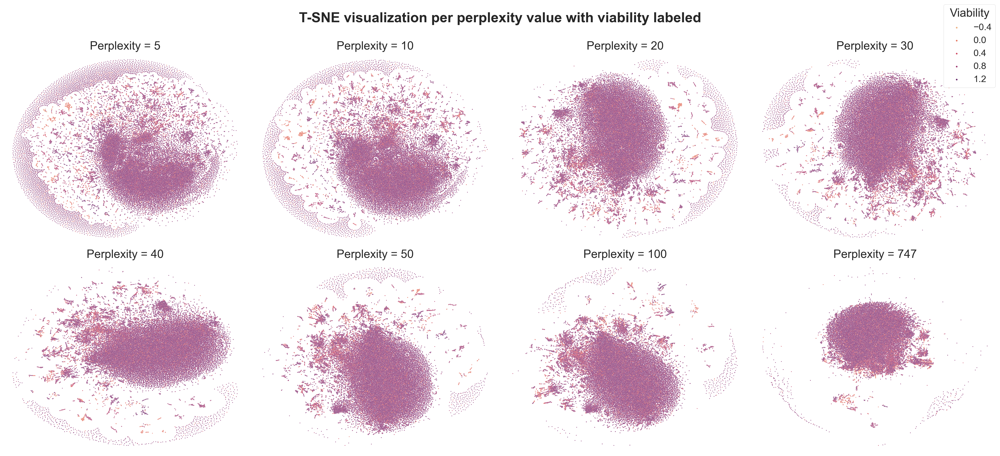

In [41]:
perplexities = [5, 10, 20, 30, 40, 50, 100, 747]
tsne_dfs = []

for p in perplexities:
    filename = f'tsne_result_perplexity_{p}.pkl'
    loaded_data = joblib.load(filename)
    tsne_dfs.append(loaded_data['df1'])  # or 'df2', 'df5' etc. if included
    print(f"Loaded: {filename}")
    
fig, axes = plt.subplots(2, 4, figsize=(60, 30))  # wider and taller figure
fig.suptitle('T-SNE visualization per perplexity value with viability labeled', fontsize=60, y=0.97, fontweight='bold')

axes = axes.flatten()

for_legend_ax = axes[0]

for i, (p, df) in enumerate(zip(perplexities, tsne_dfs)):
    ax = axes[i]
    sns.scatterplot(
        x=df[0], y=df[1],
        hue=df['label'],
        palette='flare',
        s=10,  # larger point size
        ax=ax,
        legend=(ax is for_legend_ax)   # Turn off legend in subplots, add one globally later
    )
    ax.axis('off')
    ax.set_title(f'Perplexity = {p}', fontsize=50)

# Add legend only once, outside the subplots
# Create a dummy plot to generate the legend
handles, labels = for_legend_ax.get_legend_handles_labels()
for ax in axes:
    if ax.get_legend():
        ax.get_legend().remove()
fig.legend(loc='upper right', fontsize=40, title='Viability', title_fontsize=50)


# Tighten layout and reduce space above
plt.tight_layout(rect=[0, 0.08, 1, 0.95])
plt.savefig('C:/Users/20223415/OneDrive - TU Eindhoven/Documenten/Jaar 3/Q4/Bep/Plotjes voor report/t-SNE_perplexities.pdf', dpi=300, bbox_inches='tight', facecolor='white')
plt.show()

## Results 4.2: Filtering of data

The filtering of the REMATCHED data set is performed in the first code. The visualizations used in the report section are obtained in the second code. The filtering was performed with a t-SNE visualization that was clustered with DBSCAN. Different clusters should be selected if the code is run again. 

In [ ]:
#performing t-SNE and DBSCAN
tsne = TSNE(n_components=2, perplexity=20)
embedded = tsne.fit_transform(lm_df)
tsne_df = pd.DataFrame(embedded)
db = DBSCAN(eps=1, min_samples=4)
cluster_labels_dbscan = db.fit_predict(tsne_df)
tsne_df['cluster'] = cluster_labels_dbscan

#removing the artifact and all the samples that dbscan has labeled as noise
index_artifacts_noise = tsne_df[tsne_df['cluster'].isin([-1, 20, 9, 51, 136, 137])].index #select different clusters if necessary
artifacts_noise_positions = tsne_df.index.get_indexer(index_artifacts_noise)
lm_df_clean = lm_df.drop(lm_df.index[artifacts_noise_positions])
siginfo_df_clean = siginfo_df.drop(index=index_artifacts_noise)

(-48.72139720916748, 47.47404842376709, -39.63202323913574, 52.31364097595215)

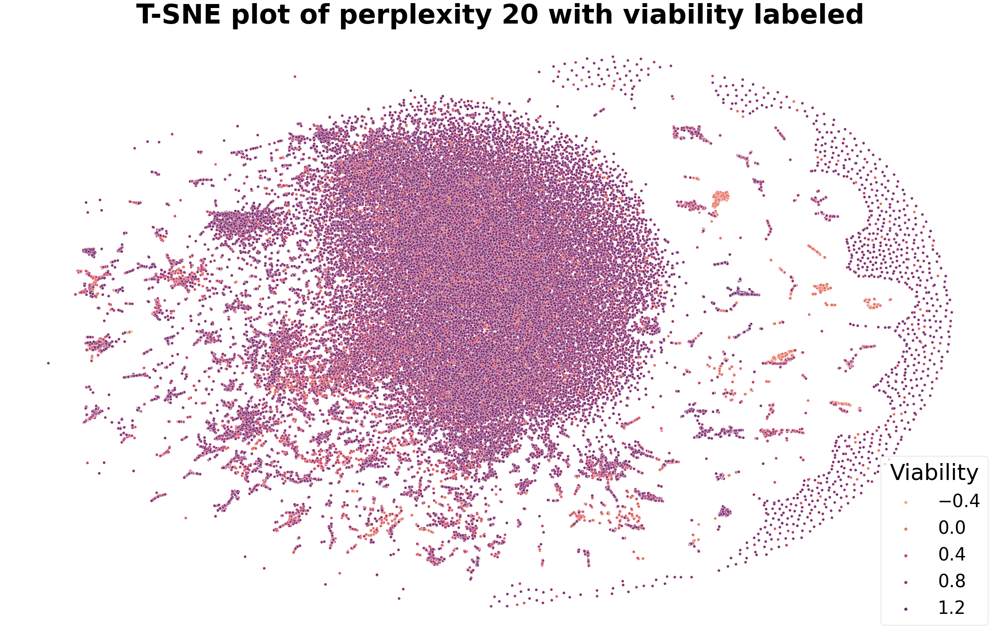

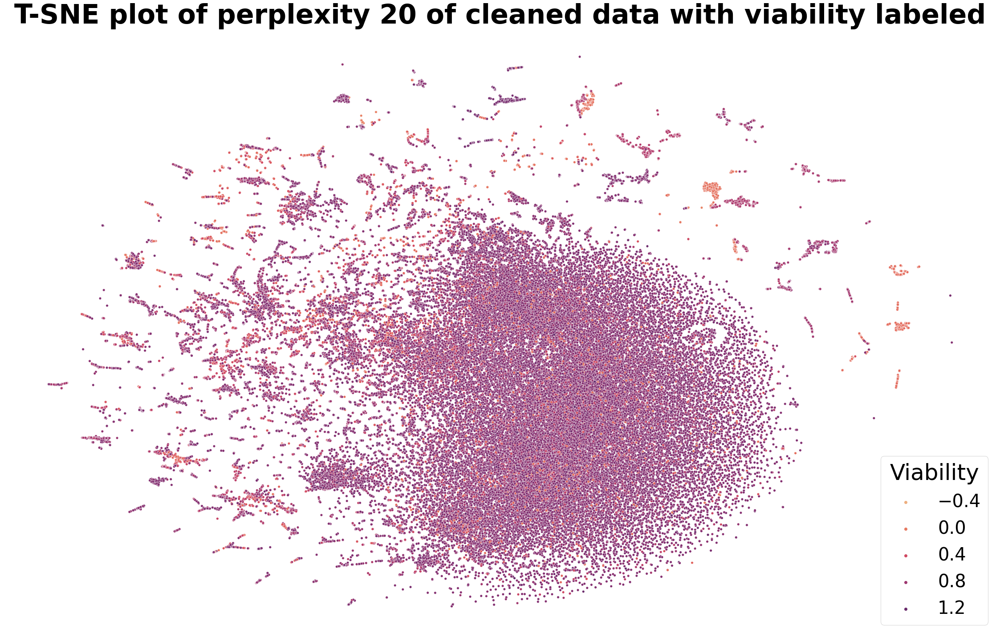

In [5]:
# accessing a previous run of t-SNE with perplexity of 20 and plotting this
loaded_data = joblib.load('full_data_perplexity_20_tsne_df')
tsne_df = loaded_data['df1']
plt.figure(figsize=(40, 25))
sns.scatterplot(data=tsne_df, x=0, y=1, s=40, hue=siginfo_df.viability.tolist(), palette='flare')
plt.legend(loc='lower right', title='Viability', prop={'size': 40}, title_fontsize='50')
plt.title("T-SNE plot of perplexity 20 with viability labeled", fontweight = 'bold', fontsize = '60')
plt.axis('off')

# accessing a previous run of t-SNE of the cleaned df with perplexity of 20 and plotting this
loaded_data = joblib.load('../BEP/Robustness of clusters data/robustness_data_p=20.pkl')
tsne_df = loaded_data['df1']
plt.figure(figsize=(40, 25))
sns.scatterplot(data=tsne_df, x=0, y=1, s=30, hue=siginfo_df_clean.viability.tolist(), palette='flare')
plt.legend(loc='lower right', title='Viability', prop={'size': 40}, title_fontsize='50')
plt.title("T-SNE plot of perplexity 20 of cleaned data with viability labeled", fontweight = 'bold', fontsize = '60')
plt.axis('off')

## Results 4.3: Robustness of t-SNE visualizations and DBSCAN clustering

In the following code section the robustness algorithm was applied to obtain the Robustness scores of the t-SNE visualizations. The calculation of the Robustness score takes a long time to run. Thus this was not performed with a for-loop but with changing the perplexity values manually. The second code is used to obtain the visualization of the Jaccard Similarity scores for different perplexity values from the report. 

### 4.3.a. Code to apply Algorithm 1

In [ ]:
#first t-SNE run
tsne_1 = TSNE(n_components=2, perplexity=50)
embedded_1 = tsne_1.fit_transform(lm_df)
tsne_df_clean_1 = pd.DataFrame(embedded_1)
labels_1 = DBSCAN(eps=1, min_samples=4).fit_predict(embedded_1)

#second t-SNE run
tsne_2 = TSNE(n_components=2, perplexity=50)
embedded_2 = tsne_2.fit_transform(lm_df)
tsne_df_clean_2 = pd.DataFrame(embedded_2)
labels_2 = DBSCAN(eps=1, min_samples=4).fit_predict(embedded_2)

#calculate robustness score
cluster_map_1 = defaultdict(set)
cluster_map_2 = defaultdict(set)

for idx, label in enumerate(labels_1):
    cluster_map_1[label].add(idx)

for idx, label in enumerate(labels_2):
    cluster_map_2[label].add(idx)

scores_rob = []

for i in tqdm(range(len(lm_df)), desc="Calculate Robustness score"):
    A = cluster_map_1[labels_1[i]] - {i}
    B = cluster_map_2[labels_2[i]] - {i}

    if A or B:
        intersection = A.intersection(B)
        union = A.union(B)
        jaccard = len(intersection) / len(union)
    else:
        jaccard = 0

    scores_rob.append(jaccard)

robustness_score = np.mean(scores_rob)
print(f"Robustness score: {robustness_score:.3f}")

### 4.3.b. Code to obtain visualizations used in the report
The codes used below are all with loaded data sets to obtain the same results every run.

<ipython-input-6-cedfb216bbb5>:35: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0.1, 1, 0.93])


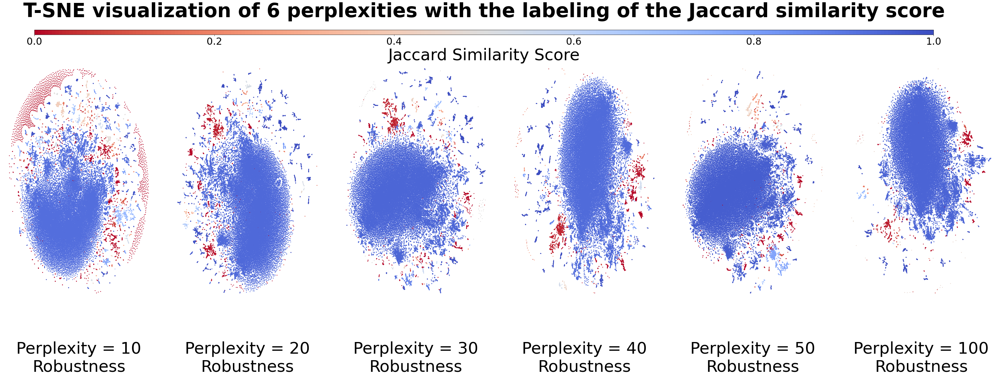

In [6]:
#T-SNE visualization with the Jaccard Similarity score labeled of the following perplexities:
perplexities = [10, 20, 30, 40, 50, 100]
tsne_dfs = []

# Load all dataframes
for p in perplexities:
    loaded_data = joblib.load(f'../BEP/Robustness of clusters data/robustness_data_p={p}.pkl')
    tsne_df = loaded_data['df1'].copy()
    tsne_df['label'] = loaded_data['df2']
    tsne_df['score'] = loaded_data['df5']
    tsne_dfs.append(tsne_df)

# Make figure wider but shorter height for shorter plots
fig, axes = plt.subplots(1, len(perplexities), figsize=(55, 14), gridspec_kw={'hspace': 0.3, 'wspace': 0.1})

fig.suptitle('T-SNE visualization of 6 perplexities with the labeling of the Jaccard similarity score', fontsize=60, y=1.05, fontweight='bold')

all_scores = pd.concat([df['score'] for df in tsne_dfs])
vmin, vmax = all_scores.min(), all_scores.max()

for i, (p, df) in enumerate(zip(perplexities, tsne_dfs)):
    ax = axes[i]
    sc = ax.scatter(df[0], df[1], c=df['score'], cmap='coolwarm_r', vmin=vmin, vmax=vmax, s=2)
    ax.axis('off')
    # Use ax.text below the plot instead of set_xlabel for more control
    ax.text(0.5, -0.15, f'Perplexity = {p}\nRobustness', ha='center', va='top', fontsize=50, transform=ax.transAxes)

# Add colorbar above plots, leave room with rect in tight_layout
cbar_ax = fig.add_axes([0.15, 0.95, 0.7, 0.015])  # [left, bottom, width, height]
cbar = fig.colorbar(sc, cax=cbar_ax, orientation='horizontal')
cbar.set_label('Jaccard Similarity Score', fontsize=50)
cbar.ax.tick_params(labelsize=30)  # Increase colorbar tick label size


# Adjust layout: leave room for big title and bottom labels, tighten the rest
plt.tight_layout(rect=[0, 0.1, 1, 0.93])
plt.show()

In [13]:
#Calculation of the amount of unstable samples and of the amount of samples with a Jaccard score below 0.8 for all used perplexities
#loading all the Jaccard scores
loaded_data = joblib.load('../BEP/Robustness of clusters data/robustness_data_p=10.pkl')
scores_rob_10 = loaded_data['df5']
loaded_data = joblib.load('../BEP/Robustness of clusters data/robustness_data_p=20.pkl')
scores_rob_20 = loaded_data['df5']
loaded_data = joblib.load('../BEP/Robustness of clusters data/robustness_data_p=30.pkl')
scores_rob_30 = loaded_data['df5']
loaded_data = joblib.load('../BEP/Robustness of clusters data/robustness_data_p=40.pkl')
scores_rob_40 = loaded_data['df5']
loaded_data = joblib.load('../BEP/Robustness of clusters data/robustness_data_p=50.pkl')
scores_rob_50 = loaded_data['df5']
loaded_data = joblib.load('../BEP/Robustness of clusters data/robustness_data_p=100.pkl')
scores_rob_100 = loaded_data['df5']
#summarizing all results in one df
df_jaccard = pd.DataFrame({
    'perp_10': scores_rob_10,
    'perp_20': scores_rob_20,
    'perp_30': scores_rob_30,
    'perp_40': scores_rob_40,
    'perp_50': scores_rob_50,
    'perp_100': scores_rob_100
})
# checking which perplexities have low Jaccard scores
under_08 = (df_jaccard < 0.8).sum()
print("Amount of samples with a Jaccard score below < 0.8 per kolom:\n", under_08)

#samples with a consistently low Jaccard score, which in the report are called unstable 
threshold_jaccard = 0.8
min_runs = 5
unstable_samples = (df_jaccard < threshold_jaccard).sum(axis=1) >= min_runs
unstable_indices = df_jaccard[unstable_samples].index
print(f"Amount of samples which are unstable with all perplexities: {len(unstable_indices)}")

Amount of samples with a Jaccard score below < 0.8 per kolom:
 perp_10     12569
perp_20      6292
perp_30      6039
perp_40      6218
perp_50      6528
perp_100     5385
dtype: int64
Amount of samples which are unstable with all perplexities: 2237


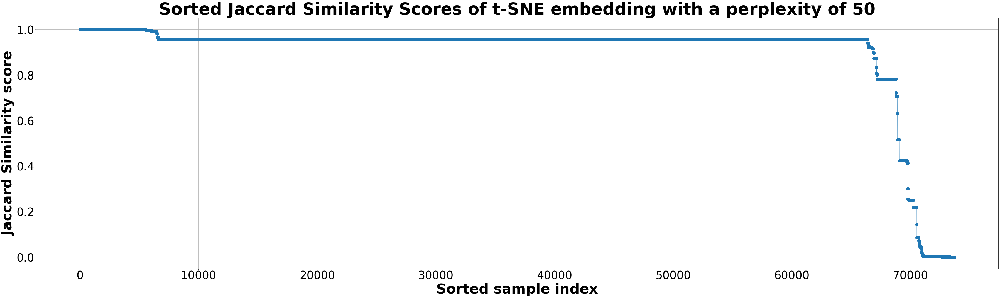

In [9]:
#Obtaining the sorted Jaccard Similarity score plot
loaded_data = joblib.load('../BEP/Robustness of clusters data/robustness_data_p=50.pkl')
scores_rob = loaded_data['df5']
plt.figure(figsize=(50, 15))
plt.plot(sorted(scores_rob, reverse=True), marker='o', linestyle='-', markersize=10)
plt.title("Sorted Jaccard Similarity scores of t-SNE embedding with a perplexity of 50", fontsize = '60', fontweight='bold')
plt.xlabel("Sorted sample index", fontsize='50', fontweight = 'bold')
plt.xticks(fontsize='40')
plt.yticks(fontsize='40')
plt.ylabel("Jaccard Similarity score", fontsize='50', fontweight = 'bold')
plt.grid(True)
plt.tight_layout()
plt.show()

(-32.400985908508304,
 44.64450473785401,
 -36.901678276062015,
 43.64245052337647)

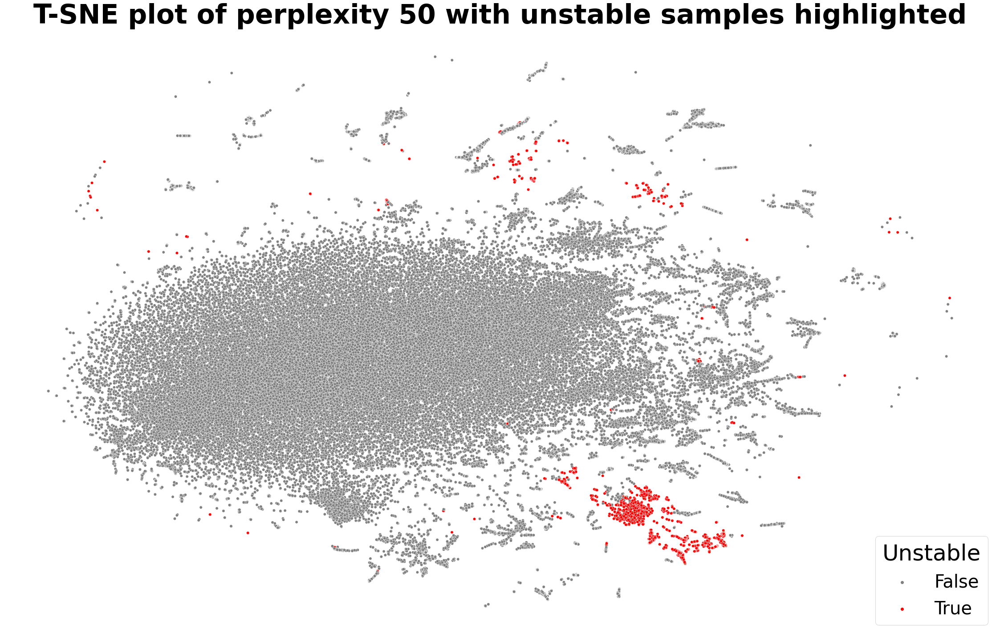

In [12]:
#Obtain the visualization with the unstable samples found in my data set colored
loaded_data = joblib.load('../BEP/Robustness of clusters data/robustness_data_p=50.pkl')
tsne_df = loaded_data['df1']
sample_names = lm_df_clean.index[tsne_df.index]
unstable_indices = unstable_signatures.copy()
unstable_mask = sample_names.isin(unstable_signatures)
tsne_df['unstable'] = unstable_mask

plt.figure(figsize=(40, 25))
sns.scatterplot(
    data=tsne_df,
    x=0, y=1,
    s=40,
    hue='unstable',
    palette={True: 'red', False: 'gray'}
)

# Add legend and styling
plt.legend(
    loc='lower right',
    title='Unstable',
    prop={'size': 40},
    title_fontsize='50'
)
plt.title("T-SNE plot of perplexity 50 with unstable samples highlighted", fontweight='bold', fontsize=60)
plt.axis('off')

### 4.3.c. Code to calculate the robustness of the clustering with the Adjusted Rand Index

In [ ]:
# Calculating the robustness of DBSCAN results with the Adjusted Rand Index
# 1. Run t-SNE once on the entire dataset 
tsne = TSNE(n_components=2, perplexity=50)
embedded = tsne.fit_transform(lm_df_masked)
tsne_df = pd.DataFrame(embedded)

# 2. Run DBSCAN on the full t-SNE output
db = DBSCAN(eps=1, min_samples=4)
cluster_labels_full = db.fit_predict(tsne_df)
tsne_df['cluster'] = cluster_labels_full

# Save original labels for comparison
original_labels = cluster_labels_full

# 3. Remove 10% of the data and re-cluster the remaining 90% 
n_samples = int(0.9 * len(lm_df_masked))
indices = np.random.choice(len(lm_df_masked), size=n_samples, replace=False)

tsne_sub = tsne_df.iloc[indices].reset_index(drop=True)

# DBSCAN on the subset
db_sub = DBSCAN(eps=1, min_samples=4)
cluster_labels_sub = db_sub.fit_predict(tsne_sub)

# 4. Compare the cluster labels (only for the shared data) 
original_sub_labels = tsne_df.iloc[indices]['cluster'].values
ari = adjusted_rand_score(original_sub_labels, cluster_labels_sub)
print(f"Adjusted Rand Index between full clustering and subset: {ari:.3f}")

## 4.4.1

Optimal Eps value based on elbow method: 1.034389


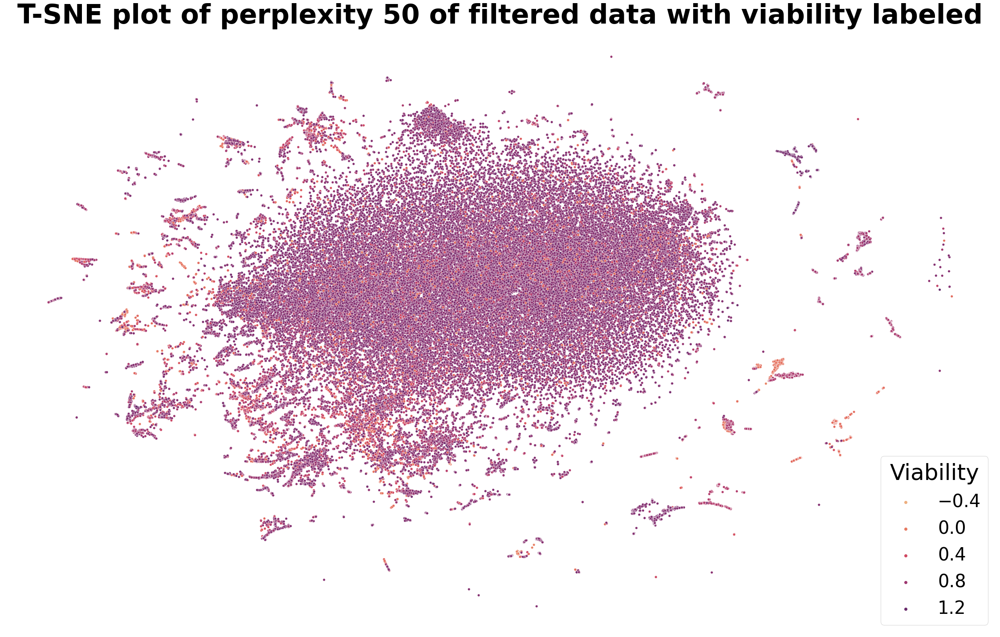

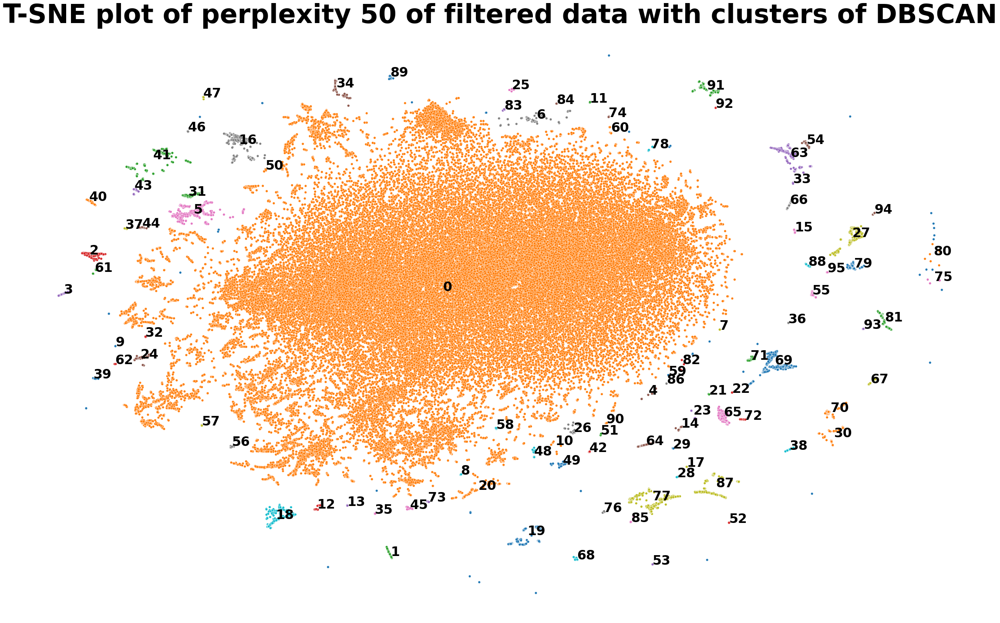

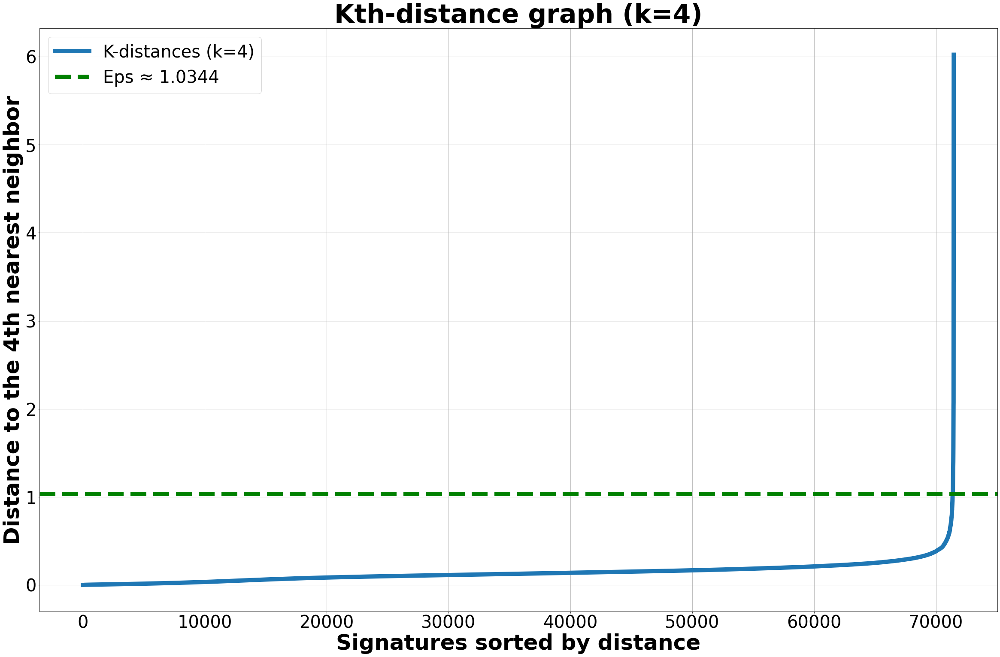

In [16]:
#t-SNE visualization of p=50 of filtered data with viability
loaded_data = joblib.load('../BEP/Robustness of clusters data/robustness_data_p=50_after_masking.pkl')
cluster_labels = loaded_data['df2']
tsne_df = loaded_data['df1']
plt.figure(figsize=(40, 25))
sns.scatterplot(data=tsne_df, x=0, y=1, s=30, hue=siginfo_masked.viability.tolist(), palette='flare')
plt.legend(loc='lower right', title='Viability', prop={'size': 40}, title_fontsize='50')
plt.title("T-SNE plot of perplexity 50 of filtered data with viability labeled", fontweight = 'bold', fontsize = '60')
plt.axis('off')

#t-SNE visualization of p=50 of filtered data with clusters
plt.figure(figsize=(40, 25))
sns.scatterplot(data=tsne_df, x=0, y=1, s=30, hue='cluster', palette='tab10', legend=False)
plt.title("T-SNE plot of perplexity 50 of filtered data with clusters of DBSCAN", fontweight = 'bold', fontsize = '60')
plt.axis('off')
for cluster_id in tsne_df['cluster'].unique():
    if cluster_id == -1:
        continue  # sla outliers over
    cluster_data = tsne_df[tsne_df['cluster'] == cluster_id]
    x_mean = cluster_data[0].mean()
    y_mean = cluster_data[1].mean()
    plt.text(x_mean, y_mean, str(cluster_id), fontsize=30, weight='bold', color='black')
    

    
#elbow plot
# Zorg dat je alleen kolommen met features gebruikt (bijv. t-SNE kolommen)
X = tsne_df[[0, 1]].values  # neem de juiste kolommen

# Stap 1: Bereken de afstand tot de 5 dichtstbijzijnde buren, 5 want eerste punt is afstand tot punt zelf
neighbors = NearestNeighbors(n_neighbors=5)
neighbors_fit = neighbors.fit(X)
distances, indices = neighbors_fit.kneighbors(X)

# Stap 2: Sorteer de afstand tot de 4e buur (index 4)
k_distances = np.sort(distances[:, 4])
x = np.arange(len(k_distances))

# Stap 3: Gebruik kneed om de knik ("elbow") te vinden
knee = KneeLocator(x, k_distances, curve="convex", direction="increasing")
eps_value = k_distances[knee.knee] if knee.knee is not None else None

# Resultaat
if eps_value is not None:
    print(f"Optimal Eps value based on elbow method: {eps_value:.6f}")
else:
    print("Geen duidelijke knie gevonden. Probeer een andere methode of kijk handmatig.")

# Stap 4: Plot
plt.figure(figsize=(40, 25))
plt.plot(x, k_distances, label='K-distances (k=4)', linewidth=10)
if eps_value is not None:
    plt.axhline(eps_value, color='g', linestyle='--', linewidth=10, label=f'Eps ≈ {eps_value:.4f}')
plt.title("Kth-distance graph (k=4)", fontsize='60', fontweight = 'bold')
plt.xlabel("Signatures sorted by distance", fontsize='50', fontweight='bold')
plt.ylabel("Distance to the 4th nearest neighbor", fontsize='50', fontweight='bold')
plt.legend(fontsize='40')
plt.xticks(fontsize='40')
plt.yticks(fontsize='40')
plt.grid(True)
plt.show()

tsne_df_cell_line = tsne_df.copy()
tsne_df_cell_line["cell_mfc_name"] = siginfo_masked["cell_mfc_name"].values

plt.figure(figsize=(50, 50))
sns.scatterplot(
    data=tsne_df_cell_line,
    x=0,
    y=1,
    hue="cell_mfc_name",
    palette="hsv",  # Gebruik bijv. tab20 of een andere grote colormap
    s=50
)

# Count unique legend items
unique_labels = tsne_df_cell_line["cell_mfc_name"].unique()
n_labels = len(unique_labels)

# Set ncol to divide items across 3 rows
ncol = int(np.ceil(n_labels / 10))

# Place legend below the plot
plt.legend(
    bbox_to_anchor=(0.5, -0.15),  # below plot
    loc='upper center',
    ncol=ncol,
    fontsize=30,
    frameon=True, title='Cell line', title_fontsize='40'
)
plt.title("T-SNE plot of perplexity 50 of filtered data with cell lines of signatures labeled", fontweight = 'bold', fontsize = '60')
plt.axis('off')
plt.tight_layout(rect=[0, 0.05, 1, 1])
plt.show()

#cluster cell lines colored
tsne_df_cell_line = tsne_df.copy()
tsne_df_cell_line["cell_mfc_name"] = siginfo_masked["cell_mfc_name"].values

plt.figure(figsize=(50, 50))
sns.scatterplot(
    data=tsne_df_cell_line,
    x=0,
    y=1,
    hue="cell_mfc_name",
    palette="hsv",  # Gebruik bijv. tab20 of een andere grote colormap
    s=50
)

# Count unique legend items
unique_labels = tsne_df_cell_line["cell_mfc_name"].unique()
n_labels = len(unique_labels)

# Set ncol to divide items across 3 rows
ncol = int(np.ceil(n_labels / 10))

# Place legend below the plot
plt.legend(
    bbox_to_anchor=(0.5, -0.15),  # below plot
    loc='upper center',
    ncol=ncol,
    fontsize=30,
    frameon=True, title='Cell line', title_fontsize='40'
)
plt.title("T-SNE plot of perplexity 50 of filtered data with cell lines of signatures labeled", fontweight = 'bold', fontsize = '60')
plt.axis('off')
plt.tight_layout(rect=[0, 0.05, 1, 1])


### Manual cluster selection

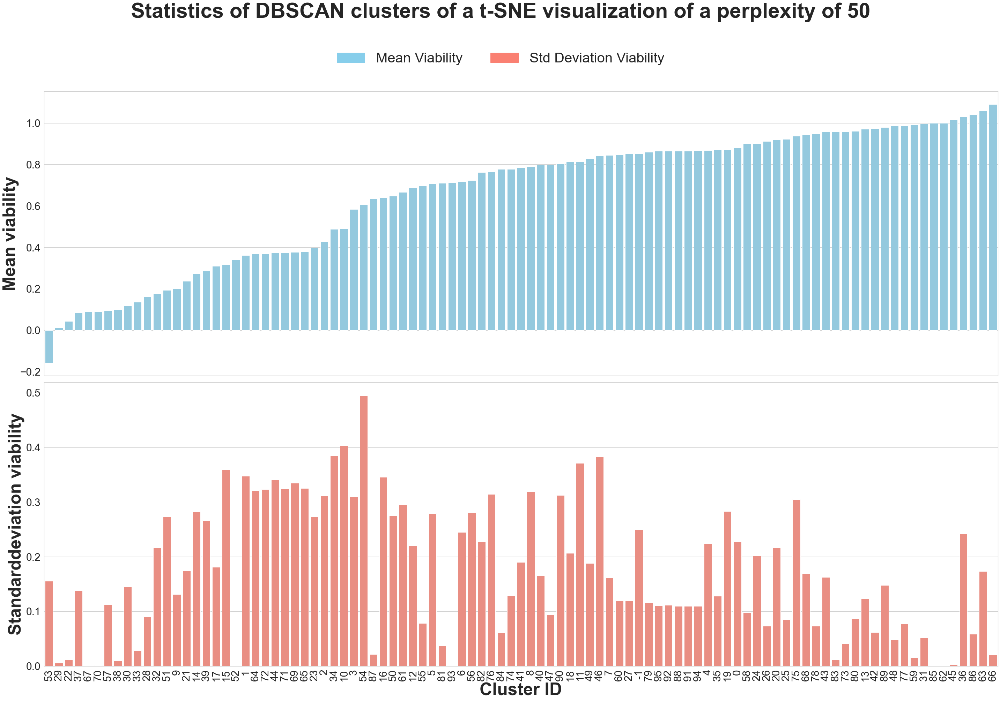

In [18]:
siginfo_masked['cluster']= cluster_labels
cluster_stats = siginfo_masked.groupby('cluster')['viability'].agg(['mean', 'std'])
cluster_stats_sorted = cluster_stats.reset_index().sort_values(by='mean', ascending=True)
cluster_stats_sorted["cluster"] = cluster_stats_sorted["cluster"].astype(str)

sns.set(style="whitegrid", palette="muted")
fig, axes = plt.subplots(2, 1, figsize=(40, 30), sharex=True)

# Move suptitle a bit closer
fig.subplots_adjust(top=0.99)

fig.suptitle(
    'Statistics of DBSCAN clusters of a t-SNE visualization of a perplexity of 50',
    fontsize=60, fontweight='bold'
)

# Plot 1: mean viability
sns.barplot(ax=axes[0], x='cluster', y='mean', data=cluster_stats_sorted, color='skyblue')
axes[0].set_ylabel("Mean viability", fontsize=50)
axes[0].set_xlabel('')
axes[0].tick_params(labelsize=30)

# Make y-label bold explicitly
axes[0].yaxis.label.set_weight('bold')

# Plot 2: std viability
sns.barplot(ax=axes[1], x='cluster', y='std', data=cluster_stats_sorted, color='salmon')
axes[1].set_ylabel("Standarddeviation viability", fontsize=50)
axes[1].set_xlabel("Cluster ID", fontsize=50)
axes[1].tick_params(labelsize=30)

# Make axis labels bold explicitly
axes[1].yaxis.label.set_weight('bold')
axes[1].xaxis.label.set_weight('bold')

# Rotate x labels on bottom plot
axes[1].set_xticklabels(cluster_stats_sorted["cluster"], rotation=90, fontsize=30)

handles = [
    Patch(color='skyblue', label='Mean Viability'),
    Patch(color='salmon', label='Std Deviation Viability')
]

# Add figure-level legend between title and plots
fig.legend(handles=handles, loc='upper center', bbox_to_anchor=(0.5, 0.93),
           fontsize=40, ncol=2, frameon=False)

plt.tight_layout(rect=[0, 0.05, 1, 0.9])
plt.show()


#Tas values
siginfo_masked['cluster'] = siginfo_masked['cluster'].astype(str)

plt.figure(figsize=(50, 20))
sns.boxplot(x='cluster', y='tas', data=siginfo_masked, palette='Set3')

plt.title('Distribution of TAS values per cluster', fontsize='60', fontweight='bold')
plt.xlabel('Cluster', fontsize='50', fontweight='bold')
plt.ylabel('TAS', fontsize='50', fontweight='bold')
plt.xticks(fontsize=30, rotation=90)
plt.yticks(fontsize=30)
plt.grid(True)
plt.show()


### manual cluster selection with different weight methods

In [19]:
#continuous scale
#removing the outliers
cluster_stats = cluster_stats[cluster_stats.index != -1]

scaler = MinMaxScaler()
scaled = scaler.fit_transform(cluster_stats[['mean', 'std']])
cluster_stats[['mean_scaled', 'std_scaled']] = scaled
cluster_stats['weight_raw'] = (1 - cluster_stats['mean_scaled']) * (1 - cluster_stats['std_scaled'])
cluster_stats['weight_scaled'] = MinMaxScaler().fit_transform(cluster_stats['weight_raw'].values.reshape(-1, 1)).flatten()

gamma = 2  # of 3 of iets anders, probeer een paar waarden
cluster_stats['weight'] = cluster_stats['weight_scaled'] ** gamma

# Mapping terug naar sample level
siginfo_masked['cluster'] = siginfo_masked['cluster'].astype(int)
cluster_stats.index = cluster_stats.index.astype(int)

siginfo_masked['cluster_weight'] = siginfo_masked['cluster'].map(cluster_stats['weight']).fillna(0)
lm_df_masked['cluster_weight'] = siginfo_masked['cluster_weight'].values

plt.figure(figsize=(30, 20))
sns.scatterplot(
    data=cluster_stats,
    x='mean',
    y='weight',
    size='std',
    hue='std',
    palette='viridis',
    sizes=(100, 1000)
)
plt.title("Continuous weight scale with a power transformation", fontsize='60', fontweight='bold', pad=20)
plt.xlabel("Mean viability per cluster", fontsize='50', fontweight='bold')
plt.ylabel("Assigned cluster weight", fontsize='50', fontweight='bold')
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.grid(True)
plt.legend(loc='upper right', title='Standard deviation of the viability', prop={'size': 30}, title_fontsize='40')
plt.tight_layout()
plt.show()

#evaluating performance
sample_weights_continuous = lm_df_masked['cluster_weight'].values

# initalising model
model = Ridge()
# Fitting model
model.fit(lm_df_masked.drop(columns=['cluster_weight']), siginfo_masked['viability'], sample_weight=sample_weights_continuous)
# Making predictions
y_pred = model.predict(mixseq_lfc)

# Calculating our performance metric (the pearson correlation between prediction and true viability value)
stat, _ = pcor(y_pred, mixseq_meta.viability)

print("The pearson correlation between viability values and the prediction viability values on the external test set (mixseq)")
print(round(stat, 4))

In [ ]:
#thresholding
# Hard cutoff toepassen
mean_cutoff = 0.4
std_cutoff = 0.2

def assign_weight(row):
    mean = row['mean']
    std = row['std']
    
    if mean < mean_cutoff and std < std_cutoff:
        return 1
    elif mean >= mean_cutoff and std < std_cutoff:
        return 0
    else:
        return 0.3

cluster_stats['weight_binary'] = cluster_stats.apply(assign_weight, axis=1)

siginfo_masked['cluster_weight'] = siginfo_masked['cluster'].map(cluster_stats['weight_binary']).fillna(0)
lm_df_masked['cluster_weight'] = siginfo_masked['cluster_weight'].values

plt.figure(figsize=(30, 25))
sns.scatterplot(
    data=cluster_stats,
    x='mean',
    y='std',
    hue='weight_binary',
    palette={0: 'hotpink', 0.3: 'lightgreen', 1: 'darkblue'},
    s=200,
)

# Cutoff lijnen
plt.axvline(x=mean_cutoff, color='red', linestyle='--', label=f'mean < {mean_cutoff}', linewidth=10)
plt.axhline(y=std_cutoff, color='purple', linestyle='--', label=f'std < {std_cutoff}', linewidth=10)

plt.title("Cluster weights based on thresholding of the mean and standard deviation of the viability", fontsize='60', fontweight='bold', pad=20)
plt.xlabel("Mean viability clusters", fontsize='50', fontweight='bold')
plt.ylabel("Standard deviation viability clusters", fontsize='50', fontweight='bold')
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.legend(loc='upper right', title='Thresholds and weights assigned', prop={'size': 30}, title_fontsize='40')
plt.grid(True)
plt.tight_layout()
plt.show()

#evaluating performance
sample_weights_continuous = lm_df_masked['cluster_weight'].values

# initalising model
model = Ridge()
# Fitting model
model.fit(lm_df_masked.drop(columns=['cluster_weight']), siginfo_masked['viability'], sample_weight=sample_weights_continuous)
# Making predictions
y_pred = model.predict(mixseq_lfc)

# Calculating our performance metric (the pearson correlation between prediction and true viability value)
stat, _ = pcor(y_pred, mixseq_meta.viability)

print("The pearson correlation between viability values and the prediction viability values on the external test set (mixseq)")
print(round(stat, 4))

In [ ]:
# eerst filteren op TAS
lm_df_masked = lm_df_masked.drop(columns=['cluster_weight'])
#probeersel van eerst filteren op tas en daarna opdelen in high en low viability
tas_threshold = 0.4
percentage_threshold = 0.3 # 40%
viability_threshold = 0.4   # pas aan naar wens

unique_clusters = siginfo_masked['cluster'].unique()

selected_clusters = []

for cluster_id in unique_clusters:
    cluster_data = siginfo_masked[siginfo_masked['cluster'] == cluster_id]
    if len(cluster_data) == 0:
        continue
    high_tas_count = (cluster_data['tas'] > tas_threshold).sum()
    high_tas_fraction = high_tas_count / len(cluster_data)
    
    if high_tas_fraction > percentage_threshold:
        selected_clusters.append(cluster_id)

# Dictionaries voor de clusters met hoge en lage viability
high_viability_clusters = {}
low_viability_clusters = {}

for cluster_id in selected_clusters:
    cluster_data = siginfo_masked[siginfo_masked['cluster'] == cluster_id]
    mean_viability = cluster_data['viability'].mean()
    
    if mean_viability >= viability_threshold:
        high_viability_clusters[cluster_id] = cluster_data
    else:
        low_viability_clusters[cluster_id] = cluster_data
 

high_keys = set(high_viability_clusters.keys())
low_keys = set(low_viability_clusters.keys())
all_clusters = set(unique_clusters)

# Medium clusters = geselecteerde clusters die niet high of low zijn
medium_clusters = all_clusters - high_keys - low_keys

print(f"Hoge viability clusters: {list(high_viability_clusters.keys())}")
print(f"Lage viability clusters: {list(low_viability_clusters.keys())}")
print(f"Medium viability clusters: {sorted(medium_clusters)}")

ignored_clusters = high_viability_clusters
important_clusters = low_viability_clusters
sample_weights_dbscan = []
for label in cluster_labels:
    if label in ignored_clusters:
        sample_weights_dbscan.append(0)
    elif label in important_clusters:
        sample_weights_dbscan.append(10)
    else:
        sample_weights_dbscan.append(1)
        
# initalising model
model = Ridge()
# Fitting model
model.fit(lm_df_masked, siginfo_masked['viability'], sample_weight=sample_weights_dbscan)
# Making predictions
y_pred = model.predict(mixseq_lfc)

# Calculating our performance metric (the pearson correlation between prediction and true viability value)
stat, _ = pcor(y_pred, mixseq_meta.viability)

print("The pearson correlation between viability values and the prediction viability values on the external test set (mixseq)")
print(round(stat, 4))

The pearson correlation between viability values and the prediction viability values on the external test set (mixseq)
0.5383
Hoge viability clusters: [5, 6, 8, 13, 18, 19, 24, 26, 36, 40, 41, 43, 45, 46, 48, 49, 52, 56, 58, 60, 62, 63, 68, 73, 76, 77, 78, 79, 81, 84, 85, 87, 89, 92, 93, 95]
Lage viability clusters: [2, 9, 14, 17, 22, 25, 27, 28, 31, 37, 39, 50, 55, 64, 65, 67, 70]
Medium viability clusters: [-1, 0, 1, 3, 4, 7, 10, 11, 12, 15, 16, 20, 21, 23, 29, 30, 32, 33, 34, 35, 38, 42, 44, 47, 51, 53, 54, 57, 59, 61, 66, 69, 71, 72, 74, 75, 80, 82, 83, 86, 88, 90, 91, 94]


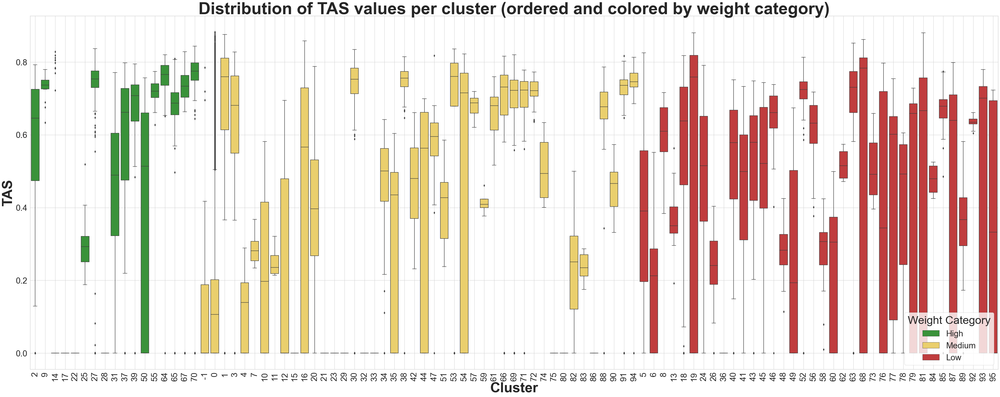

medium_weight    63964
low_weight        5203
high_weight       2303
Name: weight_category, dtype: int64


In [33]:
#manual cluster selection with manual weights
ignored_clusters = {77, 18, 63, 92, 89, 81, 93, 6, 87, 45, 73, 19, 56, 62, 5, 41, 40, 46, 13, 36, 85, 48, 43, 78, 68, 26, 24, 58, 95, 79, 60, 49, 84, 52, 8, 76}
important_clusters = {70, 55, 50, 65, 25, 22, 28, 9, 2, 37, 67, 14, 39, 17, 64, 31, 27}
unique_clusters = siginfo_masked['cluster'].unique()
all_clusters = set(unique_clusters)
medium_clusters = all_clusters - ignored_clusters - important_clusters

sample_weights_dbscan = []
for label in cluster_labels:
    if label in ignored_clusters:
        sample_weights_dbscan.append(0)
    elif label in important_clusters:
        sample_weights_dbscan.append(40)
    else:
        sample_weights_dbscan.append(1)
        
# initalising model
model = Ridge()
# Fitting model
model.fit(lm_df_masked, siginfo_masked['viability'], sample_weight=sample_weights_dbscan)
# Making predictions
y_pred = model.predict(mixseq_lfc)

# Calculating our performance metric (the pearson correlation between prediction and true viability value)
stat, _ = pcor(y_pred, mixseq_meta.viability)

print("The pearson correlation between viability values and the prediction viability values on the external test set (mixseq)")
print(round(stat, 4))
print(f"Hoge viability clusters: {sorted(ignored_clusters)}")
print(f"Lage viability clusters: {sorted(important_clusters)}")
print(f"Medium viability clusters: {sorted(medium_clusters)}")

#tas statistics
# Make sure 'cluster' is string for proper ordering and plotting
siginfo_masked['cluster'] = siginfo_masked['cluster'].astype(str)

# Convert all clusters to strings
ignored_clusters_str = {str(c) for c in ignored_clusters}
important_clusters_str = {str(c) for c in important_clusters}
medium_clusters_str = {str(c) for c in medium_clusters}

# Sort clusters within each category
sorted_high = sorted(important_clusters_str, key=int)
sorted_medium = sorted(medium_clusters_str, key=int)
sorted_low = sorted(ignored_clusters_str, key=int)

# Final cluster order for x-axis (High → Medium → Low)
cluster_order = sorted_high + sorted_medium + sorted_low

# Add weight category to dataframe for coloring
def categorize(cluster):
    if cluster in important_clusters:
        return 'High'
    elif cluster in ignored_clusters:
        return 'Low'
    else:
        return 'Medium'
    
# Convert all clusters to string format
ignored_clusters = {str(c) for c in ignored_clusters}
important_clusters = {str(c) for c in important_clusters}
medium_clusters = {str(c) for c in medium_clusters}

siginfo_masked['weight_category'] = siginfo_masked['cluster'].apply(categorize)


# Define a color palette for categories
palette = {
    'High': '#2ca02c',    # blue
    'Medium': '#ffdb58',  # orange
    'Low': '#d62728',     # green
}
category_order = ['High', 'Medium', 'Low']
siginfo_masked['weight_category'] = pd.Categorical(
    siginfo_masked['weight_category'],
    categories=category_order,
    ordered=True
)

# Group clusters by category
high_clusters = sorted(siginfo_masked[siginfo_masked['weight_category'] == 'High']['cluster'].unique(), key=int)
medium_clusters = sorted(siginfo_masked[siginfo_masked['weight_category'] == 'Medium']['cluster'].unique(), key=int)
low_clusters = sorted(siginfo_masked[siginfo_masked['weight_category'] == 'Low']['cluster'].unique(), key=int)

# Final order for x-axis
cluster_order = high_clusters + medium_clusters + low_clusters

plt.figure(figsize=(50, 20))
sns.boxplot(
    x='cluster',
    y='tas',
    data=siginfo_masked,
    order=cluster_order,  # enforced x-axis cluster order
    hue='weight_category',
    hue_order=category_order,
    palette={
        'High': '#2ca02c',
        'Medium': '#ffdb58',
        'Low': '#d62728'
    },
    dodge=False
)

plt.title('Distribution of TAS values per cluster (ordered and colored by weight category)', fontsize=60, fontweight='bold')
plt.xlabel('Cluster', fontsize=50, fontweight='bold')
plt.ylabel('TAS', fontsize=50, fontweight='bold')
plt.xticks(fontsize=30, rotation=90)
plt.yticks(fontsize=30)
plt.grid(True)
plt.legend(title='Weight Category', fontsize=30, title_fontsize=40, loc='lower right')
plt.tight_layout()
plt.savefig('C:/Users/20223415/OneDrive - TU Eindhoven/Documenten/Jaar 3/Q4/Bep/Plotjes voor report/hand selection box plots tas.png', dpi=300, bbox_inches='tight',  facecolor='white')
plt.show()

#amount of signatures per category
cluster_to_weight = {}
for cl in ignored_clusters:
    cluster_to_weight[int(cl)] = 'low_weight'
for cl in important_clusters:
    cluster_to_weight[int(cl)] = 'high_weight'
for cl in medium_clusters:
    cluster_to_weight[int(cl)] = 'medium_weight'

# Zorg dat clusters ook int zijn
siginfo_masked['cluster'] = siginfo_masked['cluster'].astype(int)

# Map de weight categories correct
siginfo_masked['weight_category'] = siginfo_masked['cluster'].map(cluster_to_weight)

# Count how many signatures are in each weight category
weight_counts = siginfo_masked['weight_category'].value_counts()

print(weight_counts)

<ipython-input-38-15a2d046c124>:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  valid_cluster_df['weight_category'] = valid_cluster_df['cluster'].apply(get_weight_category)
<ipython-input-38-15a2d046c124>:130: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax2.set_xticklabels(plot_data['moa_abbr'], rotation=45, ha='right')


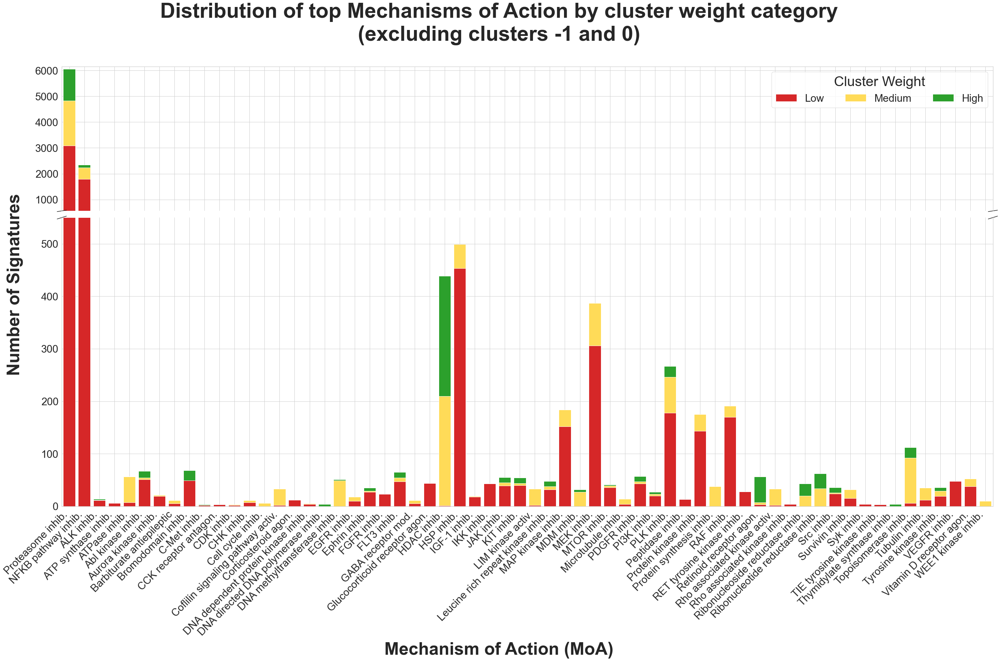

In [38]:
#MoA's of the weight categories
low_weight_clusters = {77, 18, 63, 92, 89, 81, 93, 6, 87, 45, 73, 19, 56, 62, 5, 41, 40, 46, 13, 36, 85, 48, 43, 78, 68, 26, 24, 58, 95, 79, 60, 49, 84, 52, 8, 76}
high_weight_clusters = {70, 55, 50, 65, 25, 22, 28, 9, 2, 37, 67, 14, 39, 17, 64, 31, 27}
all_clusters = set(range(-1, 96))
medium_weight_clusters = all_clusters - high_weight_clusters - low_weight_clusters

#removing all the rows that had the same pert_id and moa, as the focus is now on moa and duplicates are not wanted
moa_df_no_dup = moa_df_long[['pert_id', 'moa']].drop_duplicates()

# Merge clusters + pert_id + MoA
cluster_moa_df = siginfo_masked[['sig_id', 'pert_id', 'cluster']].merge(
    moa_df_no_dup[['pert_id', 'moa']],
    on='pert_id',
    how='left'
)

# Define cluster weight categories function
def get_weight_category(cluster):
    if cluster in high_weight_clusters:
        return 'High'
    elif cluster in low_weight_clusters:
        return 'Low'
    else:
        return 'Medium'
    
#function that shortens the names of the MoAs
def abbreviate_moa(moa):
    replacements = {
        'inhibitor': 'inhib.',
        'activator': 'activ.',
        'agonist': 'agon.',
        'antagonist': 'antag.',
        'modulator': 'mod.',
        'kinase': 'kin.',
        'receptor': 'rec.',
    }
    for long, short in replacements.items():
        if moa.endswith(long):
            return moa.replace(long, short)
    return moa  # fallback if no match

# === Filter out clusters -1 and 0 ===
valid_cluster_df = cluster_moa_df[~cluster_moa_df['cluster'].isin([-1, 0])]
valid_cluster_df['weight_category'] = valid_cluster_df['cluster'].apply(get_weight_category)

# === Count signatures per MoA and weight_category ===
moa_counts = (
    valid_cluster_df
    .groupby(['moa', 'weight_category'])
    .size()
    .unstack(fill_value=0)
    .reindex(columns=['High', 'Medium', 'Low'], fill_value=0)
)

moa_long = moa_counts.reset_index()

# === Step 1: Dominant MoAs ===
dominant_moas = ['Proteasome inhibitor', 'NFKB pathway inhibitor']

# === Step 2: Get top 20 per category excluding dominants ===
top_moas = set(dominant_moas)
for cat in ['High', 'Medium', 'Low']:
    top20 = moa_long[~moa_long['moa'].isin(top_moas)].nlargest(20, cat)['moa']
    top_moas.update(top20)

# === Step 3: Prepare plot data with categorical ordering ===
plot_data = moa_long[moa_long['moa'].isin(top_moas)].copy()
plot_data['moa'] = pd.Categorical(
    plot_data['moa'],
    categories=dominant_moas + sorted(top_moas - set(dominant_moas)),
    ordered=True
)

plot_data = plot_data.sort_values(by='moa', key=lambda x: x.cat.codes)
# Abbreviate MoA names for clearer x-axis
plot_data['moa_abbr'] = plot_data['moa'].apply(abbreviate_moa)


# === Step 4: Plotting parameters ===
colors = {'High': '#2ca02c', 'Medium': '#ffdb58', 'Low': '#d62728'}
plot_order = ['Low', 'Medium', 'High']
cutoff = 550

fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(40, 25), sharex=True, gridspec_kw={'height_ratios': [1, 2]})
bottom1 = [cutoff] * len(plot_data)
bottom2 = [0] * len(plot_data)

for cat in plot_order:
    values = plot_data[cat].values

    # Top axis: values above cutoff
    top_vals = [max(v - cutoff, 0) for v in values]
    ax1.bar(plot_data['moa_abbr'], top_vals, bottom=bottom1, color=colors[cat], label=cat)
    bottom1 = [b + tv for b, tv in zip(bottom1, top_vals)]

    # Bottom axis: values up to cutoff
    bot_vals = [min(v, cutoff) for v in values]
    ax2.bar(plot_data['moa_abbr'], bot_vals, bottom=bottom2, color=colors[cat])
    bottom2 = [b + bv for b, bv in zip(bottom2, bot_vals)]

# === Axis limits and breaks ===
ax1.margins(x=0.1)
ax2.margins(x=0.1)
ax2.set_xlim(-0.5, len(plot_data['moa_abbr']) - 0.5)
ax1.set_ylim(cutoff + 10, max(bottom1) + 100)
ax2.set_ylim(0, cutoff)

ax1.spines['bottom'].set_visible(False)
ax2.spines['top'].set_visible(False)
d = .005
kwargs = dict(transform=ax1.transAxes, color='k', clip_on=False)
ax1.plot((-d, +d), (-d, +d), **kwargs)
ax1.plot((1 - d, 1 + d), (-d, +d), **kwargs)
kwargs.update(transform=ax2.transAxes)
ax2.plot((-d, +d), (1 - d, 1 + d), **kwargs)
ax2.plot((1 - d, 1 + d), (1 - d, 1 + d), **kwargs)

# === Labels, title, and legend ===
fig.suptitle(
    "Distribution of top Mechanisms of Action by cluster weight category\n(excluding clusters -1 and 0)",
    fontsize=60, y=1.02, fontweight='bold'
)

fig.text(0.01, 0.57, 'Number of Signatures', va='center', rotation='vertical', fontsize=50, fontweight='bold')
fig.text(0.5, -0.02, 'Mechanism of Action (MoA)', ha='center', fontsize=50, fontweight='bold')

ax1.tick_params(axis='y', labelsize=30)
ax2.tick_params(axis='x', labelsize=30, rotation=45)
ax2.tick_params(axis='y', labelsize=30)
ax2.set_xticklabels(plot_data['moa_abbr'], rotation=45, ha='right')

ax1.legend(
    loc='upper right', bbox_to_anchor=(1, 1), ncol=3,
    title='Cluster Weight', prop={'size': 30},
    title_fontsize='40'
)

# === Final layout ===
fig.subplots_adjust(top=0.88)
plt.tight_layout()
plt.show()

In [ ]:
#parameter sweep van manual cluster selection
#meaning of low and high is not really correctly used, based on viability instead of weight as above
low_clusters = [2, 9, 14, 17, 22, 25, 27, 28, 31, 37, 39, 50, 55, 64, 65, 67, 70]
high_clusters = [5, 6, 8, 13, 18, 19, 24, 26, 36, 40, 41, 43, 45, 46, 48, 49, 52, 56, 58, 60, 62, 63, 68, 73, 76, 77, 78, 79, 81, 84, 85, 87, 89, 92, 93, 95]
all_clusters = set(unique_clusters)
medium_clusters = [-1, 0, 1, 3, 4, 7, 10, 11, 12, 15, 16, 20, 21, 23, 29, 30, 32, 33, 34, 35, 38, 42, 44, 47, 51, 53, 54, 57, 59, 61, 66, 69, 71, 72, 74, 75, 80, 82, 83, 86, 88, 90, 91, 94]

weight_values = [0.000000001, 1, 10, 100, 1000]


heatmap_data = pd.DataFrame(index=weight_values, columns=weight_values)

best_score = -np.inf
best_weights = None

for med_w in weight_values:
    heatmap_data = pd.DataFrame(index=weight_values, columns=weight_values)

    for low_w, high_w in product(weight_values, repeat=2):
        sample_weights = []
        for label in cluster_labels:
            if label in low_clusters:
                sample_weights.append(low_w)
            elif label in high_clusters:
                sample_weights.append(high_w)
            else:
                sample_weights.append(med_w)

        # Train model
        model = Ridge()
        model.fit(lm_df_masked, siginfo_masked['viability'], sample_weight=sample_weights)

        # Predict en bereken Pearson
        y_pred = model.predict(mixseq_lfc)
        stat, _ = pcor(y_pred, mixseq_meta.viability)

        # Opslaan
        heatmap_data.loc[high_w, low_w] = stat

        # Beste score tracken
        if stat > best_score:
            best_score = stat
            best_weights = (low_w, high_w, med_w)

    # Plot heatmap voor huidige med_w
    fig, ax = plt.subplots(figsize=(40, 35))
    heatmap = sns.heatmap(heatmap_data.astype(float), annot=True, fmt=".3f", cmap="viridis", ax=ax, annot_kws={"size": 40})
    cbar = heatmap.collections[0].colorbar
    ax.set_xlabel("High cluster weight", fontsize='50', fontweight='bold')
    ax.set_ylabel("Low cluster weight", fontsize='50', fontweight='bold')
    ax.set_title(f"Pearson correlation heatmap with medium weight = {med_w})", fontsize='60', fontweight='bold')
    ax.tick_params(axis='y', labelsize=30)
    ax.tick_params(axis='x', labelsize=30)
    cbar.set_label('Pearson correlation', fontsize=40)
    cbar.ax.tick_params(labelsize=30)
    fig.tight_layout()
    
    fig.canvas.draw()
    plt.close(fig)

# Beste combinatie over alle heatmaps
print("Beste Pearson correlatie:", round(best_score, 4))
print("Bijbehorende gewichten (low, high, medium):", best_weights)

In [ ]:
#cross validation
#meaning of low and high is not really correctly used, based on viability instead of weight as above
low_clusters = [2, 9, 14, 17, 22, 25, 27, 28, 31, 37, 39, 50, 55, 64, 65, 67, 70]
high_clusters = [5, 6, 8, 13, 18, 19, 24, 26, 36, 40, 41, 43, 45, 46, 48, 49, 52, 56, 58, 60, 62, 63, 68, 73, 76, 77, 78, 79, 81, 84, 85, 87, 89, 92, 93, 95]
all_clusters = set(unique_clusters)
medium_clusters = [-1, 0, 1, 3, 4, 7, 10, 11, 12, 15, 16, 20, 21, 23, 29, 30, 32, 33, 34, 35, 38, 42, 44, 47, 51, 53, 54, 57, 59, 61, 66, 69, 71, 72, 74, 75, 80, 82, 83, 86, 88, 90, 91, 94]

weight_values = [0.000000001, 1, 10, 100, 1000]


heatmap_data = pd.DataFrame(index=weight_values, columns=weight_values)

best_score = -np.inf
best_weights = None

for med_w in weight_values:
    heatmap_data = pd.DataFrame(index=weight_values, columns=weight_values)

    for low_w, high_w in product(weight_values, repeat=2):
        sample_weights = []
        for label in cluster_labels:
            if label in low_clusters:
                sample_weights.append(low_w)
            elif label in high_clusters:
                sample_weights.append(high_w)
            else:
                sample_weights.append(med_w)

        # Train model
        model = Ridge()
        model.fit(lm_df_masked, siginfo_masked['viability'], sample_weight=sample_weights)

        # Predict en bereken Pearson
        y_pred = model.predict(mixseq_lfc)
        stat, _ = pcor(y_pred, mixseq_meta.viability)

        # Opslaan
        heatmap_data.loc[high_w, low_w] = stat

        # Beste score tracken
        if stat > best_score:
            best_score = stat
            best_weights = (low_w, high_w, med_w)

    # Plot heatmap voor huidige med_w
    fig, ax = plt.subplots(figsize=(40, 35))
    heatmap = sns.heatmap(heatmap_data.astype(float), annot=True, fmt=".3f", cmap="viridis", ax=ax, annot_kws={"size": 40})
    cbar = heatmap.collections[0].colorbar
    ax.set_xlabel("High cluster weight", fontsize='50', fontweight='bold')
    ax.set_ylabel("Low cluster weight", fontsize='50', fontweight='bold')
    ax.set_title(f"Pearson correlation heatmap with medium weight = {med_w})", fontsize='60', fontweight='bold')
    ax.tick_params(axis='y', labelsize=30)
    ax.tick_params(axis='x', labelsize=30)
    cbar.set_label('Pearson correlation', fontsize=40)
    cbar.ax.tick_params(labelsize=30)
    fig.tight_layout()
    
    fig.canvas.draw()
    filename = f"Parameter_sweep_heatmap_medw_{med_w}.png"
    filepath = os.path.join("C:/Users/20223415/OneDrive - TU Eindhoven/Documenten/Jaar 3/Q4/Bep/Figures/Heatmaps_2", filename)
    fig.savefig(filepath)
    plt.close(fig)

# Beste combinatie over alle heatmaps
print("Beste Pearson correlatie:", round(best_score, 4))
print("Bijbehorende gewichten (low, high, medium):", best_weights)

## Category 2

In [36]:
#With weights decided by viability
viability = siginfo_df['viability']
sample_weights = np.where(
    viability > 0.7, 1,
    np.where(viability < 0.4, 100, 1000)
)
# initalising model
model = Ridge()
# Fitting model
model.fit(lm_df, siginfo_df['viability'], sample_weight=sample_weights)
# Making predictions
y_pred = model.predict(mixseq_lfc)

# Calculating our performance metric (the pearson correlation between prediction and true viability value)
stat, _ = pcor(y_pred, mixseq_meta.viability)

print("The pearson correlation between viability values and the prediction viability values on the external test set (mixseq)")
print(round(stat, 4))

The pearson correlation between viability values and the prediction viability values on the external test set (mixseq)
0.4126


In [ ]:
#with weights decided by viability and a parameter sweep
weight_values = [0.000000001, 1, 10, 100, 1000]

results = []  # To store all results

for mid_w in weight_values:
    heatmap_data = pd.DataFrame(index=weight_values, columns=weight_values)

    for high_w, low_w in product(weight_values, repeat=2):
        sample_weights = np.where(
            viability < 0.4, high_w,         # Low viability → high weight
            np.where(viability > 0.7, low_w, # High viability → low weight
                    mid_w)                 # Medium viability → medium weight
        )

        model = Ridge()
        model.fit(lm_df, siginfo_df['viability'], sample_weight=sample_weights)
        y_pred = model.predict(mixseq_lfc)
        stat, _ = pcor(y_pred, mixseq_meta.viability)

        heatmap_data.loc[high_w, low_w] = stat

        # Store all results with their weight combinations
        results.append({
            'low_weight': low_w,
            'high_weight': high_w,
            'medium_weight': mid_w,
            'pearson_corr': stat
        })

    # Plot heatmap (same as before)
    fig, ax = plt.subplots(figsize=(40, 35))
    heatmap = sns.heatmap(heatmap_data.astype(float), annot=True, fmt=".3f", cmap="viridis", ax=ax, annot_kws={"size": 40})
    cbar = heatmap.collections[0].colorbar
    ax.set_xlabel("Low weight", fontsize=50, fontweight='bold')
    ax.set_ylabel("High weight", fontsize=50, fontweight='bold')
    ax.set_title(f"Pearson correlation heatmap with medium weight = {mid_w}", fontsize=60, fontweight='bold')
    ax.tick_params(axis='y', labelsize=30)
    ax.tick_params(axis='x', labelsize=30)
    cbar.set_label('Pearson correlation', fontsize=40)
    cbar.ax.tick_params(labelsize=30)
    fig.tight_layout()

    plt.close(fig)

# Convert results to DataFrame and sort by pearson_corr descending
results_df = pd.DataFrame(results)
results_df = results_df.sort_values(by='pearson_corr', ascending=False)

print("Top 5 best Pearson correlations and weights:")
print(results_df.head(5))


In [ ]:
#with weights decided by tas and viability
tas = siginfo_df['tas']
#standard weight
sample_weights = np.full(len(siginfo_df), 5)

# Regel 1: tas < 0.2 → gewicht = 5 (deze is al standaard)
# Regel 2: tas >= 0.2 → bepaal op basis van viability
mask_tas_high = tas >= 0.2

# Binnen deze groep:
# viability > 0.7 → gewicht = 0
sample_weights[(mask_tas_high) & (viability > 0.7)] = 0

# viability < 0.4 → gewicht = 50
sample_weights[(mask_tas_high) & (viability < 0.4)] = 50

# De rest blijft 5

# initalising model
model = Ridge()
# Fitting model
model.fit(lm_df, siginfo_df['viability'], sample_weight=sample_weights)
# Making predictions
y_pred = model.predict(mixseq_lfc)

# Calculating our performance metric (the pearson correlation between prediction and true viability value)
stat, _ = pcor(y_pred, mixseq_meta.viability)

print("The pearson correlation between viability values and the prediction viability values on the external test set (mixseq)")
print(round(stat, 4))

In [ ]:
#with weigths decided by tas and viability and a parameter sweep
weight_values = [0.000000001, 1, 10, 100, 1000]

results = []  # To store all results

for mid_w in weight_values:
    heatmap_data = pd.DataFrame(index=weight_values, columns=weight_values)

    for high_w, low_w in product(weight_values, repeat=2):
        # Start with medium weight as default
        sample_weights = np.full(len(siginfo_df), mid_w)

        # Apply tas and viability-based logic
        tas = siginfo_df['tas']
        mask_tas_high = tas >= 0.2

        # High viability → low weight
        sample_weights[(mask_tas_high) & (viability > 0.7)] = low_w

        # Low viability → high weight
        sample_weights[(mask_tas_high) & (viability < 0.4)] = high_w

        # Remaining values stay mid_w

        # Train model
        model = Ridge()
        model.fit(lm_df, siginfo_df['viability'], sample_weight=sample_weights)

        # Predict
        y_pred = model.predict(mixseq_lfc)

        # Evaluate
        stat, _ = pcor(y_pred, mixseq_meta.viability)

        # Store result in heatmap
        heatmap_data.loc[high_w, low_w] = stat

        # Store full result
        results.append({
            'low_weight': low_w,
            'high_weight': high_w,
            'medium_weight': mid_w,
            'pearson_corr': stat
        })

    # Plot heatmap for this mid_w
    fig, ax = plt.subplots(figsize=(40, 35))
    heatmap = sns.heatmap(heatmap_data.astype(float), annot=True, fmt=".3f", cmap="viridis", ax=ax, annot_kws={"size": 40})
    cbar = heatmap.collections[0].colorbar
    ax.set_xlabel("Low weight", fontsize=50, fontweight='bold')
    ax.set_ylabel("High weight", fontsize=50, fontweight='bold')
    ax.set_title(f"Pearson correlation heatmap with medium weight = {mid_w} with TAS filtering", fontsize=60, fontweight='bold')
    ax.tick_params(axis='y', labelsize=30)
    ax.tick_params(axis='x', labelsize=30)
    cbar.set_label('Pearson correlation', fontsize=40)
    cbar.ax.tick_params(labelsize=30)
    fig.tight_layout()

    plt.close(fig)

# Convert all results to DataFrame
results_df = pd.DataFrame(results)
results_df = results_df.sort_values(by='pearson_corr', ascending=False)

print("Top 5 best Pearson correlations and weights:")
print(results_df.head(5))

## Comparison of three models

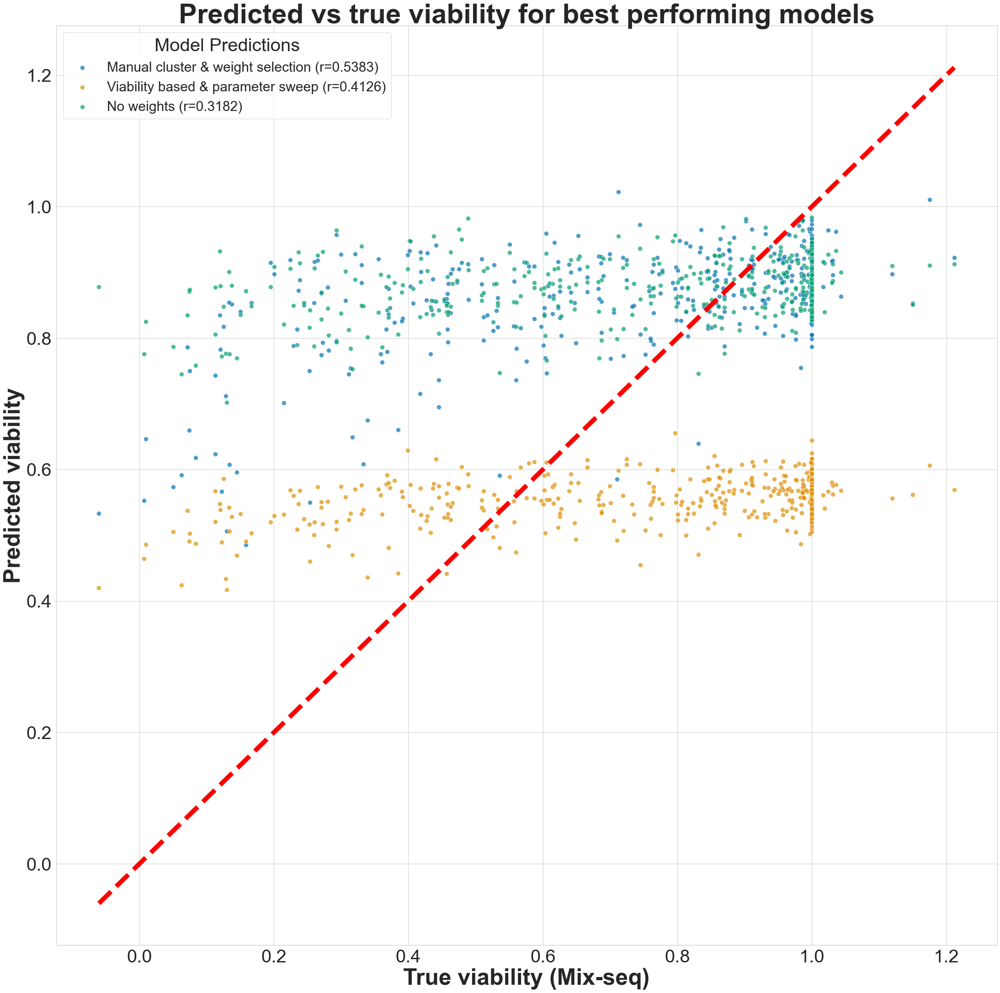

Cat 1 - Std dev: 0.082682, Mean: 0.860484
Cat 2 - Std dev: 0.036585, Mean: 0.554097
Starting model - Std dev: 0.045268, Mean: 0.876837


In [37]:
#best category 1
ignored_clusters = {77, 18, 63, 92, 89, 81, 93, 6, 87, 45, 73, 19, 56, 62, 5, 41, 40, 46, 13, 36, 85, 48, 43, 78, 68, 26, 24, 58, 95, 79, 60, 49, 84, 52, 8, 76}
important_clusters = {70, 55, 50, 65, 25, 22, 28, 9, 2, 37, 67, 14, 39, 17, 64, 31, 27}
sample_weights_dbscan = []
for label in cluster_labels:
    if label in ignored_clusters:
        sample_weights_dbscan.append(0)
    elif label in important_clusters:
        sample_weights_dbscan.append(40)
    else:
        sample_weights_dbscan.append(1)
        
# initalising model
model = Ridge()
# Fitting model
model.fit(lm_df_masked, siginfo_masked['viability'], sample_weight=sample_weights_dbscan)
# Making predictions
y_pred_cat_1 = model.predict(mixseq_lfc)

# Calculating our performance metric (the pearson correlation between prediction and true viability value)
stat, _ = pcor(y_pred, mixseq_meta.viability)

#best category 2
#With weights decided by viability
viability = siginfo_df['viability']
sample_weights = np.where(
    viability > 0.7, 1,
    np.where(viability < 0.4, 100, 1000)
)
# initalising model
model = Ridge()
# Fitting model
model.fit(lm_df, siginfo_df['viability'], sample_weight=sample_weights)
# Making predictions
y_pred_cat_2 = model.predict(mixseq_lfc)

# Calculating our performance metric (the pearson correlation between prediction and true viability value)
stat, _ = pcor(y_pred, mixseq_meta.viability)

#starting point
# initalising model
model = Ridge()
# Fitting model
model.fit(lm_df, siginfo_df['viability'])
# Making predictions
y_pred_s = model.predict(mixseq_lfc)

# Calculating our performance metric (the pearson correlation between prediction and true viability value)
stat, _ = pcor(y_pred, mixseq_meta.viability)

sns.set(style="whitegrid")
plt.figure(figsize=(30, 30))

# Calculate Pearson correlations for each prediction set
pearson_corr_1, _ = pearsonr(mixseq_meta.viability, y_pred_cat_1)
pearson_corr_2, _ = pearsonr(mixseq_meta.viability, y_pred_cat_2)
pearson_corr_s, _ = pearsonr(mixseq_meta.viability, y_pred_s)

palette = sns.color_palette("colorblind", 3)

# Plot each prediction with better colors and markers
sns.scatterplot(x=mixseq_meta.viability, y=y_pred_cat_1, alpha=0.7, label=f"Manual cluster & weight selection (r={pearson_corr_1:.4f})",
                color=palette[0], s=100)
sns.scatterplot(x=mixseq_meta.viability, y=y_pred_cat_2, alpha=0.7, label=f"Viability based & parameter sweep (r={pearson_corr_2:.4f})",
                color=palette[1], s=100)
sns.scatterplot(x=mixseq_meta.viability, y=y_pred_s, alpha=0.7, label=f"No weights (r={pearson_corr_s:.4f})",
                color=palette[2], s=100)
# Plot diagonal line
min_val = min(mixseq_meta.viability.min(), y_pred_cat_1.min(), y_pred_cat_2.min(), y_pred_s.min())
max_val = max(mixseq_meta.viability.max(), y_pred_cat_1.max(), y_pred_cat_2.max(), y_pred_s.max())
plt.plot([min_val, max_val], [min_val, max_val], color='red', linestyle='--', linewidth='10')

# Axis labels and title
plt.xlabel("True viability (Mix-seq)", fontsize='50', fontweight='bold')
plt.ylabel("Predicted viability", fontsize='50', fontweight='bold')
plt.title("Predicted vs true viability for best performing models", fontsize='60', fontweight='bold')

plt.legend(title="Model Predictions", fontsize='30', title_fontsize='40')
plt.tight_layout()
plt.xticks(fontsize='40')
plt.yticks(fontsize='40')
plt.show()

# Optional: print std and mean for each prediction
for name, y_pred in zip(["Cat 1", "Cat 2", "Starting model"], [y_pred_cat_1, y_pred_cat_2, y_pred_s]):
    print(f"{name} - Std dev: {np.std(y_pred):.6f}, Mean: {np.mean(y_pred):.6f}")
